code_ry:
[Local](./chap01_ryExercise.ipynb),
[Github](https://github.com/renyuanL/_ryDsp2020/blob/master/code/chap01_ryExercise.ipynb),
[Colab](https://colab.research.google.com/github/renyuanL/_ryDsp2020/blob/master/code/chap01_ryExercise.ipynb)


# chap01_ryExercise

## Exercises

Before you begin these exercises, you should download the code for this book, following the instructions in Section 0.2.

Solutions to these exercises are in chap01soln.ipynb.

- Exercise 1 

    - If you have Jupyter, load chap01.ipynb, read through it, and run the examples. You can also view this notebook at http://tinyurl.com/thinkdsp01.

- Exercise 2  

    - Go to http://freesound.org and download a sound sample that includes music, speech, or other sounds that have a well-defined pitch. Select a roughly half-second segment where the pitch is constant. Compute and plot the spectrum of the segment you selected. What connection can you make between the timbre of the sound and the harmonic structure you see in the spectrum?
    - Use high_pass, low_pass, and band_stop to filter out some of the harmonics. Then convert the spectrum back to a wave and listen to it. How does the sound relate to the changes you made in the spectrum?

- Exercise 3   
    - Synthesize a compound signal by creating SinSignal and CosSignal objects and adding them up. Evaluate the signal to get a Wave, and listen to it. Compute its Spectrum and plot it. What happens if you add frequency components that are not multiples of the fundamental?
    
- Exercise 4   
    - Write a function called stretch that takes a Wave and a stretch factor and speeds up or slows down the wave by modifying ts and framerate. Hint: it should only take two lines of code.

## Exercise 2
### 【rySol】

01. Get a sound object (file)

'376617__askeseverin__piano-and-violin-dramatic-sad-30-seconds.wav'

https://freesound.org/people/askeseverin/sounds/376617/


![image.png](fg/fg01_ExCh01.02.png)


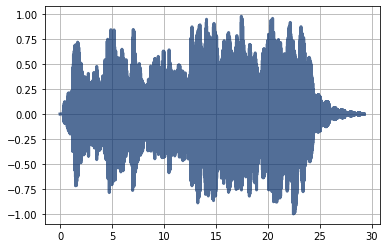

In [1]:
import thinkdsp
import matplotlib.pyplot as pl

wavFilename= 'wav/376617__askeseverin__piano-and-violin-dramatic-sad-30-seconds.wav'
aWav= thinkdsp.read_wave(wavFilename)
aWav.plot()
pl.grid()

In [2]:
aWav.make_audio()

In [3]:
aWav.duration, aWav.framerate, \
aWav.ts.shape, aWav.ts

(29.30233560090703,
 44100,
 (1292233,),
 array([0.00000000e+00, 2.26757370e-05, 4.53514739e-05, ...,
        2.93022676e+01, 2.93022902e+01, 2.93023129e+01]))

In [4]:
44100*29.30233560090703

1292233.0

In [5]:
thinkdsp.read_wave??
_='''
    # if it's in stereo, just pull out the first channel
    if nchannels == 2:
        ys = ys[::2]
'''
# 可見 2聲道 (channels) 的聲音檔會被 thinkdsp.read_wave 讀成 1聲道
# 因為 它 2點 取 1 點之緣故


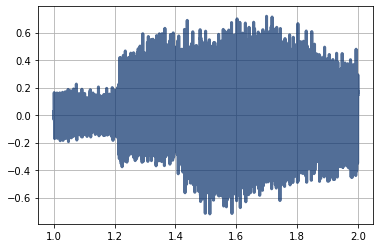

In [6]:
# Select a roughly half-second segment 
# aWav.segment?
bWav= aWav.segment(start= 1, duration= 1)
bWav.plot()
pl.grid()

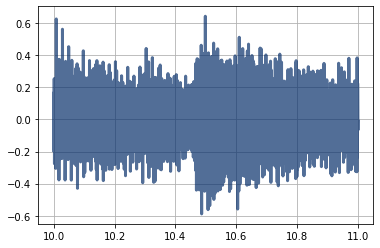

In [7]:
bWav= aWav.segment(start= 10, duration= 1.0)
bWav.plot()
pl.grid()

In [8]:
bWav.make_audio()

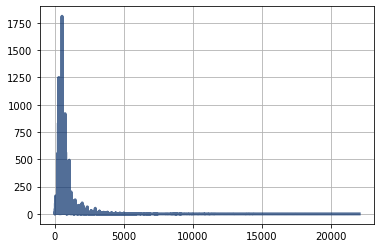

In [9]:
bSpec= bWav.make_spectrum()
bSpec.plot(); pl.grid()

### [ryCom]

What connection can you make between the `timbre` of the sound and the `harmonic structure` you see in the spectrum?

[Timbre, 音色](https://en.wikipedia.org/wiki/Timbre)

- `【音色】`（timbre）是音的特色。

    - 不同`音色`的聲音，
    - 即使在同一`音高`和同一`響度`的情況下，
    - 也能讓人區分開來。

    - 同樣的`音高`和`響度`配上不同的`音色`就好比
    - 同樣的`色相`和`明度`配上不同的`色度`一樣。


In [10]:
bSpec.low_pass??

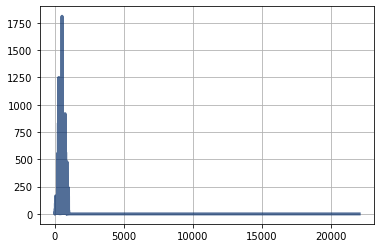

In [11]:
bSpec.low_pass(cutoff= 1000)
bSpec.plot()
pl.grid()

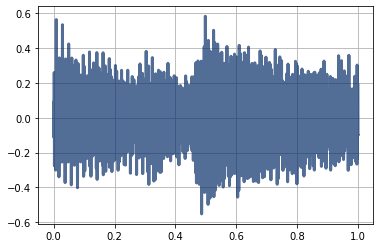

In [12]:
cWav= bSpec.make_wave()
cWav.plot();pl.grid()
cWav.make_audio()

low_pass 之後，聲音變得【模糊】、【沉悶】?

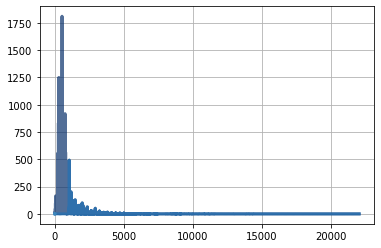

In [13]:
bSpec= bWav.make_spectrum()
bSpec.plot(); pl.grid()
bSpec.high_pass(cutoff= 1000)
bSpec.plot()
pl.grid()
dWav= bSpec.make_wave()
dWav.plot();pl.grid()
dWav.make_audio()

In [14]:
bSpec.high_pass??

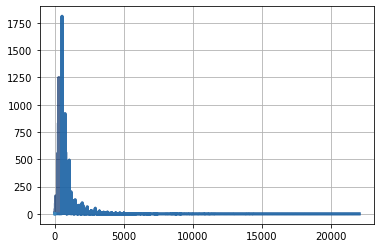

In [15]:
bSpec= bWav.make_spectrum()
bSpec.plot(); pl.grid()
bSpec.high_pass(cutoff= 500)
bSpec.plot()
pl.grid()
dWav= bSpec.make_wave()
dWav.plot();pl.grid()
dWav.make_audio()

In [16]:
bSpec.band_stop?

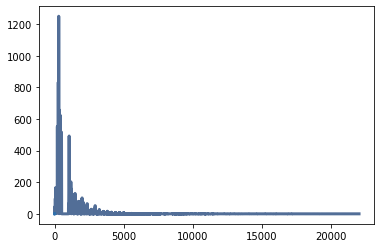

In [17]:
bSpec= bWav.make_spectrum()
bSpec.band_stop(low_cutoff=500, high_cutoff=1000, factor=0)
bSpec.plot()
pl.grid()
eWav= bSpec.make_wave()
eWav.plot();pl.grid()
eWav.make_audio()

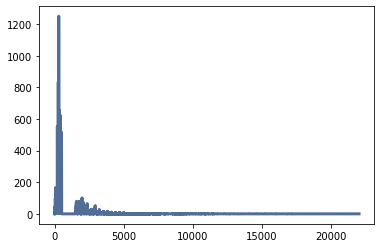

In [18]:
bSpec= bWav.make_spectrum()
bSpec.band_stop(low_cutoff=500, high_cutoff=1500, factor=0)
bSpec.plot()
pl.grid()
eWav= bSpec.make_wave()
eWav.plot();pl.grid()
eWav.make_audio()

In [23]:
## 寫一個 有互動即時反應的小小 app

#from ipywidgets import interact, interactive, fixed
#import ipywidgets as widgets
#from IPython.display import display

from ipywidgets import interact, fixed
import thinkplot

def ryFilter(   wave,  
                start=   10, 
                duration= 1, 
                lowerFreq=  100, 
                upperFreq= 1000, 
                maxFreq=   5000):
    """Selects a segment from the wave and filters it.
    
    Plots the spectrum and displays an Audio widget.
    
    wave: Wave object
    start: time in s
    duration: time in s
    lowerFreq: frequency in Hz
    upperFreq: frequency in Hz
    maxFreq: max frequence in Hz
    """
    if duration<=0:
        duration= wave.duration
            
    segment=  wave.segment(start, duration)
    
    #pl.figure()
    pl.subplot(2,1,1)
    segment.plot(); 
    pl.grid('on')
    
    spectrum= segment.make_spectrum()
    
    #pl.figure()
    pl.subplot(2,1,2)
    spectrum.plot(high=maxFreq, color='grey')
    
    spectrum.low_pass(upperFreq)
    spectrum.plot(high=maxFreq, color='red', linestyle=':', marker='o')
    
    spectrum.high_pass(lowerFreq)
    spectrum.plot(high=maxFreq, color='green', linestyle='--') 
    pl.grid('on')
    
    thinkplot.show(xlabel='Frequency (Hz)')
    
    
    audio= spectrum.make_wave().make_audio()
    display(audio)
    
wavFilename= 'wav/376617__askeseverin__piano-and-violin-dramatic-sad-30-seconds.wav'

ryWav=   thinkdsp.read_wave(wavFilename)

interact(ryFilter, 
         wave=    fixed(ryWav), 
         start=   (0, 30, 0.1), 
         duration=(0, 30, 0.1), 
         lowerFreq= (   0,  5000,  10),
         upperFreq= (   0,  5000,  10),
         maxFreq=   (1000, 10000, 100)
        )


interactive(children=(FloatSlider(value=10.0, description='start', max=30.0), FloatSlider(value=1.0, descripti…

<function __main__.ryFilter(wave, start=10, duration=1, lowerFreq=100, upperFreq=1000, maxFreq=5000)>

In [24]:
fixed?

In [25]:
bSpec.plot?

## Exercise 4   

- Write a function called `stretch` 
- that takes a Wave and a stretch factor 
- and speeds up or slows down the wave 
- by modifying ts and framerate. 

- Hint: it should only take two lines of code.

In [26]:
# [rySol]

# 思路，解題過程....

wavFilename= 'wav/376617__askeseverin__piano-and-violin-dramatic-sad-30-seconds.wav'

ryWav=   thinkdsp.read_wave(wavFilename)


In [27]:
ryWav.duration, ryWav.framerate, ryWav.ts, ryWav.ys

(29.30233560090703,
 44100,
 array([0.00000000e+00, 2.26757370e-05, 4.53514739e-05, ...,
        2.93022676e+01, 2.93022902e+01, 2.93023129e+01]),
 array([-8.79816998e-05,  0.00000000e+00,  0.00000000e+00, ...,
        -9.67798698e-04, -7.03853598e-04, -7.91835298e-04]))

In [28]:
duration=  ryWav.duration*2
ts=        ryWav.ts*2
framerate= ryWav.framerate/2
ryWav2= ryWav.copy()


In [29]:
#ryWav2.duration= duration
ryWav2.ts= ts
ryWav2.framerate= framerate
ryWav2.make_audio()

In [30]:
ryWav2??

In [31]:
ryWav.make_audio()

In [32]:
# 正式答案

def stretch(wav, factorSlow= 2):
    wav2= wav.copy()
    wav2.ts = wav.ts * factorSlow
    wav2.framerate= wav.framerate / factorSlow
    return wav2

xwav= stretch(ryWav)
xwav.make_audio()

    

In [33]:
# 多幾個測試
xwav= stretch(ryWav, factorSlow= .5)
xwav.make_audio()

In [34]:
xwav= stretch(ryWav, factorSlow= 1.5)
xwav.make_audio()


In [35]:
xwav= stretch(ryWav, factorSlow= .3)
xwav.make_audio()


In [36]:
xwav= stretch(ryWav, factorSlow= 1.2)
xwav.make_audio()



# An exercise a day, Keep the teacher away ~~~

[an Exercise by the teacher](./chap01_ryExercise.ipynb)

- 開始做習題，以 .ipynb 的形式，先放在你自己的硬碟上，
- 接下來學習如何放在 Github 上，再告訴老師你的 連結。

# 規律做 Exercise 的好處

[The Top 10 Benefits of Regular Exercise](https://www.healthline.com/nutrition/10-benefits-of-exercise)
